<a href="https://colab.research.google.com/github/KenObata/Music4All_personal_project/blob/main/week11_SMOTE_on_word2vec_en_10genre.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Week11: This notebook is to apply SMOTE on genre classification using Word2Vec.

Situation: English only (=multi-class).
Split: StratifiedKfold.
Reference: https://github.com/jasonwei20/eda_nlp


### Preprocess: import files

In [1]:
#Check RAM size. If small, you can upgrade.
#you can enable a high-RAM runtime via Runtime > Change runtime type in the menu
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 54.8 gigabytes of available RAM

You are using a high-RAM runtime!


In [2]:
!pip install scikit-multilearn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 89 kB 2.7 MB/s 


In [3]:
import os
import sys
import numpy as np
import pandas as pd
import matplotlib
import matplotlib.pyplot as plt
import sklearn
from collections import Counter

from skmultilearn.model_selection import IterativeStratification   
from sklearn.model_selection import StratifiedKFold
from scipy.sparse import csr_matrix
plt.style.use('seaborn')

CSV_FOLDER = 'drive/MyDrive/music4all/'
LANG_DIR = 'drive/MyDrive/music4all/split-language_only-artist_grouped'
SPLIT_DIR = 'drive/MyDrive/music4all/split-all_labels'
FIG_DIR = 'drive/MyDrive/music4all/figures'

font = {'size': 22}

matplotlib.rc('font', **font)

scikit-multilearn has to be installed from pip
https://github.com/scikit-multilearn/scikit-multilearn/issues/142

In [4]:
def write_txt(path, list_of_str):
    with open(path, 'w') as f:
        for value in list_of_str:
            f.write(value)
            f.write('\n')

In [5]:
def analyze_genre_tag_df(df, target_column:int, top_n=100):
    """plot the occurrences of top_n items in the given df"""
    def get_counter(items: list):
        """items: list of list"""    
        items = [g.split(',') for g in items]
        items = [item for sublist in items for item in sublist]
        items = Counter(items)    
        return items
    
    def plot_freqs(counter: Counter, top_n, title=''):
        most_common = counter.most_common(top_n)
        names, counts = list(zip(*most_common))

        xs = np.arange(len(names))
        plt.figure(figsize=(18, 7))
        plt.bar(xs, counts)
        plt.xticks(xs + 0.2, names, rotation=60, size=17, ha='right') 
        plt.title('Top-%d %s (out of %d in total)' % (top_n, title, len(counter)), size=20)
        plt.ylabel('occurrence', size=17)
        
    column_name = df.columns[target_column]
    labels = df[column_name].tolist()
    labels = get_counter(labels)
    
    print('Number of %s: %d' % (column_name, len(labels)))

    plot_freqs(labels, top_n=top_n, title=column_name)
    return labels
    
def analyze_genre_tag_csv(csv_path, top_n):
    """wrapper of analyze_genre_tag_df"""
    basename = os.path.basename(csv_path)
    df = pd.read_csv(os.path.join(CSV_FOLDER, csv_path), header=0, sep='	')
    df.head()
    return analyze_genre_tag_df(df, target_column=1,top_n=top_n)

### Data preparation

id_genres.csv

Number of genres: 853


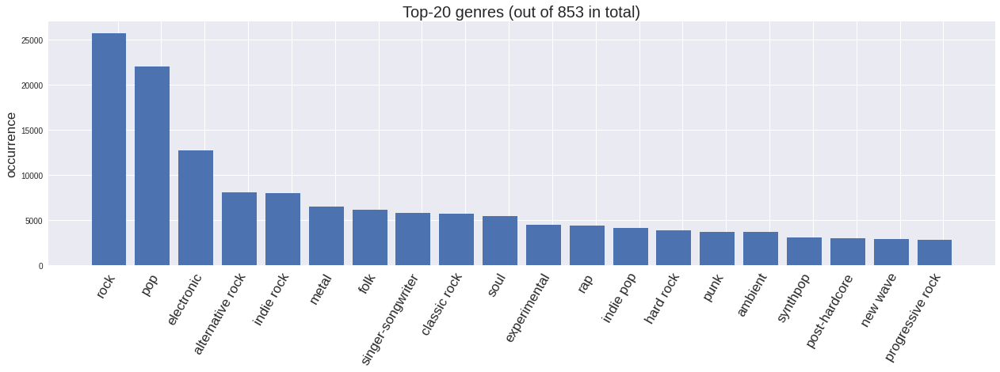

In [6]:
genre_counter = analyze_genre_tag_csv('id_genres.csv', top_n=20)
plt.tight_layout()
plt.savefig(os.path.join(FIG_DIR, 'occurrence-genre.png'))

In [7]:
genre_counter = sorted(genre_counter.items(), key=lambda item: item[1], reverse = True)
genre_counter_top = genre_counter[:15]

In [8]:
genre_counter_top_list = [genre for genre, count in genre_counter_top ]
genre_counter_top_list

['rock',
 'pop',
 'electronic',
 'alternative rock',
 'indie rock',
 'metal',
 'folk',
 'singer-songwriter',
 'classic rock',
 'soul',
 'experimental',
 'rap',
 'indie pop',
 'hard rock',
 'punk']

In [9]:
#filter genre dataset as top15 genre only and later inner join with English.
df_genres = pd.read_csv(os.path.join(CSV_FOLDER, 'id_genres.csv'), header=0, sep='	')
df_genre_top20 = df_genres[df_genres['genres'].isin(genre_counter_top_list)]
df_genre_top20

,id,genres
0,0009fFIM1eYThaPg,pop
11,00P2bHdWFkghmDqz,soul
14,00XWljDxNBgBKEEA,pop
16,00b6fV3nx5z2b8Ls,pop
26,013QDoTqbexEwkHr,pop
...,...,...
109253,zzgS4ZqyswamEWNj,pop
109254,zziALZG1JQ2uUjcy,metal
109262,zzx8CWdM7qkxKQpC,indie rock
109265,zzz0n04uuTUA7fNh,pop


Dataframe narrowed down to 18603 rows. Notice that rank20 has only 169 data. So depending on the result we might need to narrow down to top10 genre?

### Filter only English
 Note that this split have overlapping artist in both sets. See artist-grouped-stratified-split for an improved version.

In [10]:
en_lang =['en']
df_lang = pd.read_csv(os.path.join(CSV_FOLDER, 'id_lang.csv'), header=0, sep='	')
df_lang_en=df_lang[ df_lang['lang'].isin(en_lang) ]
df_lang_en

,id,lang
0,0009fFIM1eYThaPg,en
1,0010xmHR6UICBOYT,en
2,002Jyd0vN4HyCpqL,en
3,006TYKNjNxWjfKjy,en
4,007LIJOPQ4Sb98qV,en
...,...,...
109264,zzyyPUs7hC9Nz2e1,en
109265,zzz0n04uuTUA7fNh,en
109266,zzzj3LYaZtYtbzSr,en
109267,zzznMjZAKnJJXQSj,en


Originally it was 109269 rows, and now there are 84103 rows.

### Now, combine split by language and genre, so we classify each genre by language.

In [11]:
# merge three dataframes into one
df_genre_by_lang = pd.concat([df_genre_top20['id'], df_genre_top20['genres'], df_lang_en['lang']]
                             , join='inner' ,axis=1)

#Do inner join
df_genre_by_lang


,id,genres,lang
0,0009fFIM1eYThaPg,pop,en
11,00P2bHdWFkghmDqz,soul,en
16,00b6fV3nx5z2b8Ls,pop,en
26,013QDoTqbexEwkHr,pop,en
30,01EKNot8qVgZpKM7,rock,en
...,...,...,...
109253,zzgS4ZqyswamEWNj,pop,en
109254,zziALZG1JQ2uUjcy,metal,en
109262,zzx8CWdM7qkxKQpC,indie rock,en
109265,zzz0n04uuTUA7fNh,pop,en


ToDo: concatenate to the dataframe!

In [12]:
final_genre_list = ["pop", "rock", "soul", "indie rock", "rap", "electronic", "folk", "singer-songwriter", "indie pop", "punk"]
#df_lang_en=df_lang[ df_lang['lang'].isin(en_lang) ]
df_genre_by_lang = df_genre_by_lang[ df_genre_by_lang["genres"].isin(final_genre_list) ]

After inner join, we can drop the bottom 5, alternative rock, hard rock, experimental, classic rock, and metal

Reindex

In [13]:
df_genre_by_lang = df_genre_by_lang.reset_index(drop=True)
df_genre_by_lang

,id,genres,lang
0,0009fFIM1eYThaPg,pop,en
1,00P2bHdWFkghmDqz,soul,en
2,00b6fV3nx5z2b8Ls,pop,en
3,013QDoTqbexEwkHr,pop,en
4,01EKNot8qVgZpKM7,rock,en
...,...,...,...
13535,zzT504Z94j1IAuc3,indie rock,en
13536,zzgS4ZqyswamEWNj,pop,en
13537,zzx8CWdM7qkxKQpC,indie rock,en
13538,zzz0n04uuTUA7fNh,pop,en


### Get lyrics document as dataframe and append to X_train, X_test

In [14]:
#create lyric column
df_genre_by_lang["lyric"] = ""
df_genre_by_lang

,id,genres,lang,lyric
0,0009fFIM1eYThaPg,pop,en,
1,00P2bHdWFkghmDqz,soul,en,
2,00b6fV3nx5z2b8Ls,pop,en,
3,013QDoTqbexEwkHr,pop,en,
4,01EKNot8qVgZpKM7,rock,en,
...,...,...,...,...
13535,zzT504Z94j1IAuc3,indie rock,en,
13536,zzgS4ZqyswamEWNj,pop,en,
13537,zzx8CWdM7qkxKQpC,indie rock,en,
13538,zzz0n04uuTUA7fNh,pop,en,


In [15]:
#create temporary lyric folder on google collab
# do not read texts from google drive. it is slow.
ZIP_FILE ="drive/MyDrive/music4all/lyrics.zip"

!unzip drive/MyDrive/music4all/lyrics.zip -d /content/

Streaming output truncated to the last 5000 lines.
  inflating: /content/__MACOSX/lyrics/._zdBYCzbDNIMuhViX.txt  
  inflating: /content/lyrics/ZDcFZHxn0FRohOUR.txt  
  inflating: /content/__MACOSX/lyrics/._ZDcFZHxn0FRohOUR.txt  
  inflating: /content/lyrics/zDCpdnbZRALOWkmA.txt  
  inflating: /content/__MACOSX/lyrics/._zDCpdnbZRALOWkmA.txt  
  inflating: /content/lyrics/zDDcHl1LkyDHddfD.txt  
  inflating: /content/__MACOSX/lyrics/._zDDcHl1LkyDHddfD.txt  
  inflating: /content/lyrics/ZdddE8E7syeob5Pm.txt  
  inflating: /content/__MACOSX/lyrics/._ZdddE8E7syeob5Pm.txt  
  inflating: /content/lyrics/ZdDk9TB3qpmNrFPl.txt  
  inflating: /content/__MACOSX/lyrics/._ZdDk9TB3qpmNrFPl.txt  
  inflating: /content/lyrics/zddluWGNq7d8zESq.txt  
  inflating: /content/__MACOSX/lyrics/._zddluWGNq7d8zESq.txt  
  inflating: /content/lyrics/ZDdsBqLxEJrjMseV.txt  
  inflating: /content/__MACOSX/lyrics/._ZDdsBqLxEJrjMseV.txt  
  inflating: /content/lyrics/zddXIHhmYcWpzZvS.txt  
  inflating: /content/__MACOS

### This time, apply stemming and normilize words

In [16]:
from nltk.stem.porter import PorterStemmer
stemmer = PorterStemmer()

In [17]:
text = "This is a test sentence. Yo, 123 today2022"
text= text.replace(',', '')
text = text.replace('.', '')
text_tokens = [stemmer.stem(word) for word in text.split(' ') ]
print(text_tokens)

#text_tokens_alphabet = []
#for word in text.split(' '):
#  temp_word = stemmer.stem(word)
#  print("temp:", temp_word)
#  if temp_word.isalpha():
#    text_tokens_alphabet.append(temp_word)
text_tokens_alphabet = [stemmer.stem(word) for word in text.split(' ') if word.isalpha()]
print(text_tokens_alphabet)

['thi', 'is', 'a', 'test', 'sentenc', 'yo', '123', 'today2022']
['thi', 'is', 'a', 'test', 'sentenc', 'yo']


This study removes "," and "." to get only alphabets.

In [18]:
#First 5000
LYRICS_FOLDER ="lyrics/"
lyric_dict={}

df_genre_by_lang['number_of_line'] = 0
#df_genre_by_lang['text_split'] = []
for idx, row in df_genre_by_lang.loc[0:5000].iterrows():
  #print(row['id'])
  filename=LYRICS_FOLDER+row['id']+".txt"
  try:
    with open(filename, 'r') as file:
      lyric_document = file.read()
      number_of_line = lyric_document.count('\n')

      lyric_document = lyric_document.replace('\n', ' ').replace(',', '').replace('.', '')
      lyric_document.lower()
      text_split = [stemmer.stem(word) for word in lyric_document.split(' ') if word.isalpha() ]
      lyric_document=[' '.join(text_split) ]
      
      #df_genre_by_lang.loc[df_genre_by_lang.id == row['id'], "text_split"] =text_split
      df_genre_by_lang.loc[df_genre_by_lang.id == row['id'], "lyric"] = lyric_document
      df_genre_by_lang.loc[df_genre_by_lang.id == row['id'], "number_of_line"] = number_of_line
      #print(lyric_document)

  except Exception as e:
    print(e)


In [19]:
#index 5001 ~ 7988
LYRICS_FOLDER ="lyrics/"
lyric_dict={}

for idx, row in df_genre_by_lang.loc[5001:df_genre_by_lang.shape[0]].iterrows():
  #print(row['id'])
  filename=LYRICS_FOLDER+row['id']+".txt"
  try:
    with open(filename, 'r') as file:
      lyric_document = file.read()
      number_of_line = lyric_document.count('\n')

      lyric_document = lyric_document.replace('\n', ' ').replace(',', '').replace('.', '')
      lyric_document.lower()
      text_split = [stemmer.stem(word) for word in lyric_document.split(' ') if word.isalpha() ]
      lyric_document=[' '.join(text_split) ]

      #df_genre_by_lang.loc[df_genre_by_lang.id == row['id'], "text_split"] =text_split
      df_genre_by_lang.loc[df_genre_by_lang.id == row['id'], "lyric"] = lyric_document
      df_genre_by_lang.loc[df_genre_by_lang.id == row['id'], "number_of_line"] = number_of_line
      #print(lyric_document)

  except Exception as e:
    print(e)


In [20]:
#Reindex again
df_genre_by_lang = df_genre_by_lang.reset_index(drop=True)

In [21]:
df_genre_by_lang[0:df_genre_by_lang.shape[0]]

,id,genres,lang,lyric,number_of_line
0,0009fFIM1eYThaPg,pop,en,a sunni day so i got nowher to hide not a clou...,91
1,00P2bHdWFkghmDqz,soul,en,tell me a tale that alway wa sing me a song th...,36
2,00b6fV3nx5z2b8Ls,pop,en,a buh a buh you went to school to learn girl t...,74
3,013QDoTqbexEwkHr,pop,en,like a convers where stop to breath is it my i...,20
4,01EKNot8qVgZpKM7,rock,en,say the word i cannot say say them on anoth da...,31
...,...,...,...,...,...
13535,zzT504Z94j1IAuc3,indie rock,en,think what afraid of come in you know been mad...,18
13536,zzgS4ZqyswamEWNj,pop,en,oh yeah yeah last night i took a walk in the s...,75
13537,zzx8CWdM7qkxKQpC,indie rock,en,innoc it come easi in a sens it never will acc...,34
13538,zzz0n04uuTUA7fNh,pop,en,girl you know how i feel i realli sinc you bee...,65


In [22]:
df_genre_by_lang.shape[0]

13540

### Data Preparation(Kfold split)

Create dataframe for Gensim

In [23]:
def load_data(df_col, y):
    texts, labels = [], []
    
    for line in df_col:
        # texts are already tokenized, just split on space
        # in a real use-case we would put more effort in preprocessing
        texts.append(line.split(' '))
    return pd.DataFrame({'texts': texts, 'labels': y})

In [24]:
data = load_data(df_genre_by_lang["lyric"], df_genre_by_lang["genres"])

In [25]:
data

,texts,labels
0,"[a, sunni, day, so, i, got, nowher, to, hide, ...",pop
1,"[tell, me, a, tale, that, alway, wa, sing, me,...",soul
2,"[a, buh, a, buh, you, went, to, school, to, le...",pop
3,"[like, a, convers, where, stop, to, breath, is...",pop
4,"[say, the, word, i, cannot, say, say, them, on...",rock
...,...,...
13535,"[think, what, afraid, of, come, in, you, know,...",indie rock
13536,"[oh, yeah, yeah, last, night, i, took, a, walk...",pop
13537,"[innoc, it, come, easi, in, a, sens, it, never...",indie rock
13538,"[girl, you, know, how, i, feel, i, realli, sin...",pop


In [26]:
data['labels'] = data['labels'].astype('category')
label_mapping = data['labels'].cat.categories
data['labels'] = data['labels'].cat.codes
X = data['texts']
y = data['labels']

In [27]:
type(X)

pandas.core.series.Series

In [28]:
def StratifiedKFold_feature_and_df_glove(df, feature_list, y_name):
  skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=1209)  # 20% for test set 
  y = df[y_name]
  skf.get_n_splits(df[ feature_list ], y)

  splits = []

  for train_index, test_index in skf.split(df[ feature_list ], y):
      print("TRAIN:", train_index, "TEST:", test_index)
      X_train, X_test = df[ feature_list ].loc[train_index], df[ feature_list ].loc[test_index]
      y_train, y_test = y.loc[train_index], y.loc[test_index]
      splits.append({'X_train': X_train, 'X_test': X_test, 'y_train':y_train, 'y_test':y_test })
  return splits

In [29]:
def StratifiedKFold_feature_and_df(X, y):
  skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=1209)  # 20% for test set 
  #y = df[y_name]
  skf.get_n_splits(X, y)#df[ feature_list ]

  splits = []

  for train_index, test_index in skf.split(X, y):#df[ feature_list ]
      print("TRAIN:", train_index, "TEST:", test_index)
      X_train, X_test = X.loc[train_index], X.loc[test_index]
      y_train, y_test = y.loc[train_index], y.loc[test_index]
      splits.append({'X_train': X_train, 'X_test': X_test, 'y_train':y_train, 'y_test':y_test })
  return splits

In [30]:
#feature_list = ["texts"] #this is BOW and TF-IDF
#splits = StratifiedKFold_feature_and_df( data, feature_list, 'labels')
splits = StratifiedKFold_feature_and_df( X,y)

TRAIN: [    0     1     3 ... 13537 13538 13539] TEST: [    2     4     5 ... 13526 13532 13535]
TRAIN: [    0     2     4 ... 13535 13536 13539] TEST: [    1     3     7 ... 13530 13537 13538]
TRAIN: [    0     1     2 ... 13537 13538 13539] TEST: [    8    14    22 ... 13521 13531 13536]
TRAIN: [    0     1     2 ... 13537 13538 13539] TEST: [   10    12    15 ... 13523 13525 13534]
TRAIN: [    1     2     3 ... 13536 13537 13538] TEST: [    0     6    11 ... 13529 13533 13539]


In [31]:
split0=splits[0]
print(split0['X_train'].shape)
print(split0['y_train'].shape)
print(split0['X_test'].shape)
print(split0['y_test'].shape)

(10832,)
(10832,)
(2708,)
(2708,)


In [32]:
split0['X_train']

0        [a, sunni, day, so, i, got, nowher, to, hide, ...
1        [tell, me, a, tale, that, alway, wa, sing, me,...
3        [like, a, convers, where, stop, to, breath, is...
6        [lock, up, tight, like, i, would, never, feel,...
7        [sittin, in, the, crib, dreamin, about, leer, ...
                               ...                        
13534    [grandma, cooki, nigga, shout, out, to, fronto...
13536    [oh, yeah, yeah, last, night, i, took, a, walk...
13537    [innoc, it, come, easi, in, a, sens, it, never...
13538    [girl, you, know, how, i, feel, i, realli, sin...
13539    [wwi, oh, must, go, on, stand, you, break, tha...
Name: texts, Length: 10832, dtype: object

In [33]:
split0['y_train']

0        4
1        9
3        4
6        4
7        6
        ..
13534    6
13536    4
13537    3
13538    4
13539    8
Name: labels, Length: 10832, dtype: int8

### Apply SMOTE to only X_train, y_train

### Gensim tutorial (just get an idea)
We start off by using the Gensim's implementation of the algorithm to provide a high-level intuition

In [ ]:
# 1. magic for inline plot
# 2. magic to print version
# 3. magic so that the notebook will reload external python modules
# 4. magic to enable retina (high resolution) plots
# https://gist.github.com/minrk/3301035
%matplotlib inline
#%load_ext watermark
#%load_ext autoreload
#%autoreload 2
#%config InlineBackend.figure_format='retina'

import numpy as np
import pandas as pd
from time import time
from joblib import cpu_count
from collections import Counter
from gensim.models import Word2Vec
from sklearn.datasets import fetch_20newsgroups

#%watermark -a 'Ethen' -d -t -v -p numpy,scipy,pandas,sklearn,gensim

In [ ]:
#1.get tokens
sentences = [doc.strip().split() for doc in df_genre_by_lang["lyric"]]
workers = cpu_count()
word2vec = Word2Vec(sentences, workers=workers)

df_word_vectors = pd.DataFrame(word2vec.wv.vectors, index=word2vec.wv.index2word)

print('word vector dimension: ', df_word_vectors.shape)
df_word_vectors.head()

word vector dimension:  (9064, 100)


,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
i,-0.800160,0.278445,0.616723,-1.850679,-0.243606,-0.159848,-0.187531,0.242383,1.016139,1.043221,...,1.761008,0.014820,1.128096,-0.181728,-1.817522,-0.242002,0.049728,-0.234114,0.991519,0.138619
you,-0.058115,0.633599,0.936194,-1.211895,0.130602,0.495386,-0.949224,0.834391,0.413257,1.444911,...,1.822084,-0.901080,0.828782,-0.287923,-0.525164,-1.309346,0.375887,-0.647614,0.882894,-0.027557
the,-0.594405,-0.655725,-0.199975,0.794792,-0.514655,-0.845281,-1.917121,0.603086,-1.064571,-0.036216,...,-0.334884,0.921137,-0.283468,0.892571,0.625400,-0.455149,-1.311178,-0.117722,-0.689197,0.722005
to,-1.496916,-1.281025,-1.405763,-2.159792,-1.563161,-0.127464,-0.931371,1.585452,0.022781,-0.428566,...,-0.368637,0.332182,0.775043,-1.793711,-0.574595,-2.432863,-1.752674,-0.607721,2.045213,1.021053
and,-1.133762,0.001975,0.086416,-0.435770,-0.028911,-0.013798,0.417273,0.663988,0.429166,0.541093,...,-0.085363,-0.242709,0.132588,0.153363,-0.006016,-0.563488,-0.775959,0.029221,0.243106,0.952337


Note to myself: how to change dimensionality and how much does it matter?
The lack of experiments for embedding size implies that the performance is not very sensitive to this parameter. But the number of dimensions can affect training time.

https://datascience.stackexchange.com/questions/51404/word2vec-how-to-choose-the-embedding-size-parameter


In [ ]:
word2vec.wv.most_similar(positive=['love'], topn=5)

[('fall', 0.5465957522392273),
 ('you', 0.5428623557090759),
 ('babi', 0.5350711345672607),
 ('believ', 0.5331696271896362),
 ('true', 0.5272446870803833)]

There is a window size hyperparameter to the algorithm that quantifies the word "nearby". A typical window size might be 5, meaning 5 words behind and 5 words ahead (10 in total).

In [ ]:
word2vec.corpus_total_words

3468147

In [ ]:
vocab = word2vec.wv.vocab
index2word = word2vec.wv.index2word
print(len(vocab))
print(len(index2word))

9064
9064


In [ ]:
pd.set_option('display.max_rows', df_word_vectors.shape[1]+1)
df_word_vectors

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
i,-0.800160,0.278445,0.616723,-1.850679,-0.243606,-0.159848,-0.187531,0.242383,1.016139,1.043221,...,1.761008,0.014820,1.128096,-0.181728,-1.817522,-0.242002,0.049728,-0.234114,0.991519,0.138619
you,-0.058115,0.633599,0.936194,-1.211895,0.130602,0.495386,-0.949224,0.834391,0.413257,1.444911,...,1.822084,-0.901080,0.828782,-0.287923,-0.525164,-1.309346,0.375887,-0.647614,0.882894,-0.027557
the,-0.594405,-0.655725,-0.199975,0.794792,-0.514655,-0.845281,-1.917121,0.603086,-1.064571,-0.036216,...,-0.334884,0.921137,-0.283468,0.892571,0.625400,-0.455149,-1.311178,-0.117722,-0.689197,0.722005
to,-1.496916,-1.281025,-1.405763,-2.159792,-1.563161,-0.127464,-0.931371,1.585452,0.022781,-0.428566,...,-0.368637,0.332182,0.775043,-1.793711,-0.574595,-2.432863,-1.752674,-0.607721,2.045213,1.021053
and,-1.133762,0.001975,0.086416,-0.435770,-0.028911,-0.013798,0.417273,0.663988,0.429166,0.541093,...,-0.085363,-0.242709,0.132588,0.153363,-0.006016,-0.563488,-0.775959,0.029221,0.243106,0.952337
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
pokerfac,-0.016569,0.123909,0.056520,0.022082,-0.008591,0.158159,0.155094,0.075683,-0.032497,-0.049617,...,-0.088305,0.116288,0.012353,0.123279,-0.007653,-0.014898,0.068128,0.061397,0.104556,-0.040107
hmhmhm,0.038124,-0.065494,0.105090,-0.045127,0.018538,0.040099,0.142828,-0.110125,0.060656,-0.000679,...,-0.088140,-0.028688,-0.004452,0.036412,0.090694,0.001487,-0.034560,0.009269,-0.006224,-0.028499
godlik,0.017683,0.072747,-0.016210,0.070079,0.047217,0.001642,0.113524,-0.058738,-0.047990,-0.008263,...,-0.200532,-0.029663,0.062833,0.095948,0.118929,-0.039697,-0.068868,0.036672,0.018352,0.061350
cumbersom,-0.061416,0.065269,0.136911,0.130808,-0.122506,0.028844,0.161685,-0.068522,0.039193,0.016348,...,-0.129440,0.054622,0.030056,0.100531,0.162656,0.071618,-0.085701,0.004820,-0.008060,0.058037


In [ ]:
word_list=["i", "you"]
for word in word_list:
  if word in word2vec.wv.vocab:
    print(word_vectors[word_vectors.index == word])

         0         1         2         3         4         5         6   \
i -1.176629 -0.239475  1.801253 -1.562074 -0.341725  0.409897  0.975755   

        7         8        9   ...        90        91        92        93  \
i  0.53211  0.681169  0.65472  ...  1.220595  0.518247  1.190472 -0.255398   

         94        95        96        97        98        99  
i -0.943246 -1.599212  1.110626 -0.284637  0.432613  0.195238  

[1 rows x 100 columns]
           0         1         2         3         4         5         6   \
you -0.026712  0.040031  1.278777 -0.806608  0.519405  1.024626 -0.389982   

           7         8         9   ...        90        91        92  \
you  0.729406  0.411377  1.392578  ...  0.468803 -0.359175  0.323869   

           93        94        95        96        97        98        99  
you  0.169051 -0.569325 -2.561946  0.417715 -0.861875  0.046312  0.740354  

[1 rows x 100 columns]


### (Part1) Gensim Implementation

Parameter

sg=1 means to use skip-gram

min_count... is a threashhold that the algorithm requires a word need to appear at least x time ot be considered as part of skip-gram algorithm.

size... is the # of dimensions.

iterations ... ?


In [34]:
!pip3 install transformers #==4.11.3

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 4.4 MB 4.0 MB/s 
     |████████████████████████████████| 101 kB 11.9 MB/s 
     |████████████████████████████████| 6.6 MB 53.1 MB/s 
     |████████████████████████████████| 596 kB 60.7 MB/s 
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


The word2vec model has window 5, negative sampling =5, and using Skipgram.

In [35]:
import numpy as np
from sklearn.base import BaseEstimator, TransformerMixin
from gensim.models import Word2Vec


class GensimWord2VecVectorizer(BaseEstimator, TransformerMixin):
    """
    Word vectors are averaged across to create the document-level vectors/features.
    gensim's own gensim.sklearn_api.W2VTransformer doesn't support out of vocabulary words,
    hence we roll out our own.
    All the parameters are gensim.models.Word2Vec's parameters.
    https://radimrehurek.com/gensim/models/word2vec.html#gensim.models.word2vec.Word2Vec
    """

    def __init__(self, size=100, alpha=0.025, window=5, min_count=5, max_vocab_size=None,
                 sample=0.001, seed=1, workers=3, min_alpha=0.0001, sg=0, hs=0, negative=5,
                 ns_exponent=0.75, cbow_mean=1, hashfxn=hash, iter=5, null_word=0,
                 trim_rule=None, sorted_vocab=1, batch_words=10000, compute_loss=False,
                 callbacks=(), max_final_vocab=None):
        self.size = size
        self.alpha = alpha
        self.window = window
        self.min_count = min_count
        self.max_vocab_size = max_vocab_size
        self.sample = sample
        self.seed = seed
        self.workers = workers
        self.min_alpha = min_alpha
        self.sg = sg
        self.hs = hs
        self.negative = negative
        self.ns_exponent = ns_exponent
        self.cbow_mean = cbow_mean
        self.hashfxn = hashfxn
        self.iter = iter
        self.null_word = null_word
        self.trim_rule = trim_rule
        self.sorted_vocab = sorted_vocab
        self.batch_words = batch_words
        self.compute_loss = compute_loss
        self.callbacks = callbacks
        self.max_final_vocab = max_final_vocab

    def fit(self, X, y=None):
        self.model_ = Word2Vec(
            sentences=X, corpus_file=None,
            size=self.size, alpha=self.alpha, window=self.window, min_count=self.min_count,
            max_vocab_size=self.max_vocab_size, sample=self.sample, seed=self.seed,
            workers=self.workers, min_alpha=self.min_alpha, sg=self.sg, hs=self.hs,
            negative=self.negative, ns_exponent=self.ns_exponent, cbow_mean=self.cbow_mean,
            hashfxn=self.hashfxn, iter=self.iter, null_word=self.null_word,
            trim_rule=self.trim_rule, sorted_vocab=self.sorted_vocab, batch_words=self.batch_words,
            compute_loss=self.compute_loss, callbacks=self.callbacks,
            max_final_vocab=self.max_final_vocab)
        return self

    def transform(self, X):
      #words is list of token in 1 song.
      #after _get_embedding, we get a vector representation of this one song.
        X_embeddings = np.array([self._get_embedding(words) for words in X])
        return X_embeddings

    def _get_embedding(self, words):
        valid_words = [word for word in words if word in self.model_.wv.vocab]
        if valid_words:
            #if there are 9000 valid_words, then embedding for this song is 9000 x 100.
            embedding = np.zeros((len(valid_words), self.size), dtype=np.float32)
            for idx, word in enumerate(valid_words):
                embedding[idx] = self.model_.wv[word]
            #axis=0 gets average of each dimension.
            #So, _get_embedding returns a vector representation of this one song.
            return np.mean(embedding, axis=0) 
        else:
            return np.zeros(self.size)

In [38]:
from xgboost import XGBClassifier
from sklearn.pipeline import Pipeline
#import transformers
#from transformers import GensimWord2VecVectorizer

gensim_word2vec_tr = GensimWord2VecVectorizer(size=50, min_count=3, sg=1, alpha=0.025, iter=10)
xgb_clf = XGBClassifier(learning_rate=0.01, n_estimators=100, n_jobs=-1)

In [ ]:
"""
w2v_xgb = Pipeline([
    ('w2v', gensim_word2vec_tr), 
    ('xgb', xgb)
])
w2v_xgb
"""

### XGB without smote

In [41]:
gensim_word2vec_tr = gensim_word2vec_tr.fit(split0['X_train'])

In [42]:
gensim_word2vec_tr.model_.wv.vocab

{'a': <gensim.models.keyedvectors.Vocab at 0x7fb3c9741050>,
 'sunni': <gensim.models.keyedvectors.Vocab at 0x7fb3c9744d50>,
 'day': <gensim.models.keyedvectors.Vocab at 0x7fb3c9744bd0>,
 'so': <gensim.models.keyedvectors.Vocab at 0x7fb3c9744d90>,
 'i': <gensim.models.keyedvectors.Vocab at 0x7fb3c9744910>,
 'got': <gensim.models.keyedvectors.Vocab at 0x7fb3c9751150>,
 'nowher': <gensim.models.keyedvectors.Vocab at 0x7fb3c9751090>,
 'to': <gensim.models.keyedvectors.Vocab at 0x7fb3c9751250>,
 'hide': <gensim.models.keyedvectors.Vocab at 0x7fb3c9744b90>,
 'not': <gensim.models.keyedvectors.Vocab at 0x7fb3c9751190>,
 'cloud': <gensim.models.keyedvectors.Vocab at 0x7fb3c9751290>,
 'in': <gensim.models.keyedvectors.Vocab at 0x7fb3c97511d0>,
 'the': <gensim.models.keyedvectors.Vocab at 0x7fb3c9751210>,
 'sky': <gensim.models.keyedvectors.Vocab at 0x7fb3c97512d0>,
 'pretend': <gensim.models.keyedvectors.Vocab at 0x7fb3c9751310>,
 'someth': <gensim.models.keyedvectors.Vocab at 0x7fb3c9751390>,


In [43]:
X_embeddings = gensim_word2vec_tr.transform(split0['X_train'])

In [44]:
X_embeddings

array([[-0.22357307,  0.03650083, -0.01164017, ..., -0.17966922,
        -0.01709937, -0.0760886 ],
       [-0.07791618,  0.17865904, -0.08030355, ..., -0.2890782 ,
         0.10225124, -0.13182984],
       [-0.19963446,  0.1304445 ,  0.008112  , ..., -0.20512639,
         0.05927631, -0.12785994],
       ...,
       [-0.15901676,  0.10474285,  0.00956598, ..., -0.25221196,
         0.05938251, -0.15945594],
       [-0.09725425,  0.18702352, -0.03257566, ..., -0.21275117,
         0.02093409, -0.1453829 ],
       [-0.25838816,  0.07287285,  0.03680944, ..., -0.19041698,
        -0.02872983, -0.11664677]], dtype=float32)

In [45]:
X_embeddings.shape

(10832, 50)

X_embeddings is a represenation of each song whose row is a vector representation in 50 dimensions.

In [39]:
split0['y_train']

0        4
1        9
3        4
6        4
7        6
        ..
13534    6
13536    4
13537    3
13538    4
13539    8
Name: labels, Length: 10832, dtype: int8

In [46]:
from xgboost import XGBClassifier

xgb_clf.fit(X_embeddings, split0['y_train'])
xgb_clf

XGBClassifier(learning_rate=0.01, n_jobs=-1, objective='multi:softprob')

Transform test songs to word2vec representation matrix

In [47]:
X_test_embeddings = gensim_word2vec_tr.transform(split0['X_test'])

In [49]:
print(X_test_embeddings.shape, len(split0['y_test']) )

(2708, 50) 2708


In [50]:
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import accuracy_score,classification_report

y_test_pred = xgb_clf.predict(X_test_embeddings)
print(classification_report(split0['y_test'], y_test_pred) )

              precision    recall  f1-score   support

           0       0.50      0.01      0.01       190
           1       0.50      0.01      0.02       173
           2       0.00      0.00      0.00       135
           3       0.00      0.00      0.00       216
           4       0.41      0.98      0.58      1036
           5       0.69      0.12      0.20        76
           6       0.75      0.65      0.69       195
           7       0.18      0.03      0.05       290
           8       0.00      0.00      0.00       139
           9       0.00      0.00      0.00       258

    accuracy                           0.43      2708
   macro avg       0.30      0.18      0.16      2708
weighted avg       0.32      0.43      0.28      2708



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [51]:
from sklearn.metrics import balanced_accuracy_score
balanced_accuracy_score(split0['y_test'], y_test_pred)

0.1785818934052309

Note: the flow is
1. feed lyrics doc into gensim_word2vec_tr (WordVec instance) to generate the model. At this point, we don't have the numeric values yet. The purpose is to fix the vocaburary and the dimension to decide the model we use.This is done by gensim_word2vec_tr.fit(X)
2. By transform(self, X), we generate the numeric matirx.
3. Now that we have the matrix, we can SMOTE for minor X. So, for each minor song, for each token in the song, get the vector, and at the end of song, we have 2D matrix to represent the song, so feed to SMOTE to generate X more songs.
4.Now we have 10000 of 2D matrix. xgb_clf.fit()?

### XGB With smote

In [52]:
from imblearn.over_sampling import SMOTE

X_resampled, y_resampled = SMOTE().fit_resample(X_embeddings, split0['y_train']) 
print(sorted(Counter(y_resampled).items()))

[(0, 4143), (1, 4143), (2, 4143), (3, 4143), (4, 4143), (5, 4143), (6, 4143), (7, 4143), (8, 4143), (9, 4143)]


In [55]:
print(X_resampled.shape, y_resampled.shape)

(41430, 50) (41430,)


In [56]:
xgb_clf_SMOTE = XGBClassifier(learning_rate=0.01, n_estimators=100, n_jobs=-1)
xgb_clf_SMOTE.fit(X_resampled, y_resampled)
xgb_clf_SMOTE

XGBClassifier(learning_rate=0.01, n_jobs=-1, objective='multi:softprob')

In [57]:
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import accuracy_score,classification_report

y_test_pred_SMOTE = xgb_clf_SMOTE.predict(X_test_embeddings)
print(classification_report(split0['y_test'], y_test_pred_SMOTE) )

              precision    recall  f1-score   support

           0       0.13      0.16      0.14       190
           1       0.14      0.27      0.18       173
           2       0.10      0.11      0.10       135
           3       0.18      0.09      0.12       216
           4       0.52      0.23      0.32      1036
           5       0.12      0.41      0.19        76
           6       0.53      0.75      0.62       195
           7       0.26      0.06      0.09       290
           8       0.10      0.12      0.11       139
           9       0.15      0.38      0.21       258

    accuracy                           0.24      2708
   macro avg       0.22      0.26      0.21      2708
weighted avg       0.32      0.24      0.24      2708



In [58]:
from sklearn.metrics import balanced_accuracy_score
balanced_accuracy_score(split0['y_test'], y_test_pred_SMOTE)

0.2573060720728174

How do we know that which token is in which row?? => X_embedding is vector representation (=after word embedding lookup) of each song.

In [59]:
confusion_matrix(split0['y_test'], y_test_pred_SMOTE)

array([[ 30,  25,  11,   8,  44,  20,   7,   6,   7,  32],
       [ 15,  47,  11,   9,  20,  24,   1,   4,  23,  19],
       [  7,  25,  15,   7,  24,  13,   5,   2,  18,  19],
       [ 22,  36,  17,  20,  24,  30,   7,   3,  19,  38],
       [ 96,  95,  50,  36, 238,  58,  65,  21,  37, 340],
       [  5,   5,   4,   3,   7,  31,   8,   0,   4,   9],
       [  2,   1,   6,   4,   5,  15, 146,   0,   4,  12],
       [ 30,  47,  12,   8,  35,  38,  15,  16,  23,  66],
       [ 17,  37,  11,   9,   9,  13,   5,   4,  17,  17],
       [ 13,  27,  15,   5,  54,  11,  17,   6,  13,  97]])

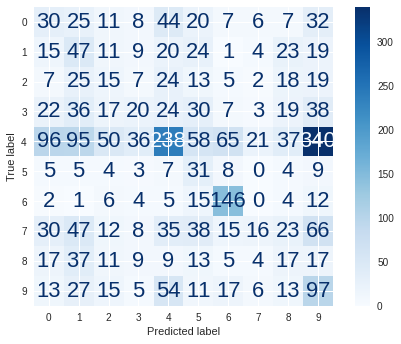

In [60]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(split0['y_test'], y_test_pred_SMOTE
                                        , cmap=plt.cm.Blues)
#plt.figure(figsize=(10, 10))
plt.show()

Comment: to use SMOTE, we cannot use XGB Classifier as this is decision tree based algorithm.

gensim.fit(X,y) X is a list of token to feed into word embedding. But SMOTE is numeric. So I could not apply SMOTE. Also, if we apply SMOTE, this is not TF-IDF value anymore. What value do we SMOTE ? If we want numeric data, it is word representation, but it does not have y label anymore... So how do we SMOTE?


### Gensim SVM without SMOTE

In [61]:
from sklearn import svm
import numpy as np
from sklearn import metrics

clf_svm_NO_SMOTE = svm.SVC(C=1.0, kernel='linear', degree=3, gamma='auto')

In [62]:
clf_svm_NO_SMOTE.fit(X_embeddings, split0['y_train'])
clf_svm_NO_SMOTE

SVC(gamma='auto', kernel='linear')

In [63]:
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import accuracy_score,classification_report

y_test_svm_pred = clf_svm_NO_SMOTE.predict(X_test_embeddings)
print(classification_report(split0['y_test'], y_test_svm_pred) )

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       190
           1       0.00      0.00      0.00       173
           2       0.00      0.00      0.00       135
           3       0.00      0.00      0.00       216
           4       0.40      0.98      0.57      1036
           5       0.00      0.00      0.00        76
           6       0.79      0.68      0.73       195
           7       0.00      0.00      0.00       290
           8       0.00      0.00      0.00       139
           9       0.00      0.00      0.00       258

    accuracy                           0.43      2708
   macro avg       0.12      0.17      0.13      2708
weighted avg       0.21      0.43      0.27      2708



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [64]:
from sklearn.metrics import balanced_accuracy_score
balanced_accuracy_score(split0['y_test'], y_test_svm_pred)

0.16656420156420157

### Gensim - SVM with SMOTE

In [66]:
from sklearn import svm

clf_svm_SMOTE = svm.SVC(C=1.0, kernel='linear', degree=3, gamma='auto')

clf_svm_SMOTE.fit(X_resampled, y_resampled)
clf_svm_SMOTE

SVC(gamma='auto', kernel='linear')

In [67]:
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.metrics import accuracy_score,classification_report

y_test_svm_SMOTE_pred = clf_svm_SMOTE.predict(X_test_embeddings)
print(classification_report(split0['y_test'], y_test_svm_SMOTE_pred) )

              precision    recall  f1-score   support

           0       0.15      0.21      0.18       190
           1       0.16      0.31      0.21       173
           2       0.09      0.16      0.11       135
           3       0.17      0.15      0.16       216
           4       0.60      0.19      0.29      1036
           5       0.14      0.46      0.21        76
           6       0.65      0.77      0.70       195
           7       0.22      0.08      0.11       290
           8       0.14      0.14      0.14       139
           9       0.17      0.40      0.24       258

    accuracy                           0.25      2708
   macro avg       0.25      0.29      0.24      2708
weighted avg       0.36      0.25      0.25      2708



In [68]:
from sklearn.metrics import balanced_accuracy_score
balanced_accuracy_score(split0['y_test'], y_test_svm_SMOTE_pred)

0.28782692933784904

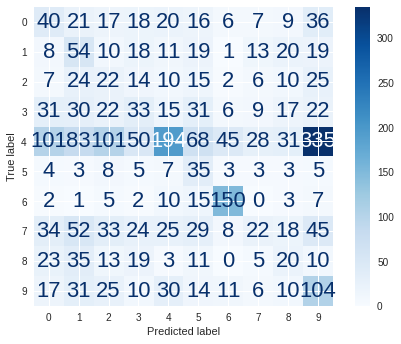

In [69]:
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
ConfusionMatrixDisplay.from_predictions(split0['y_test'], y_test_svm_SMOTE_pred
                                        , cmap=plt.cm.Blues)
#plt.figure(figsize=(10, 10))
plt.show()

### Pasrameter Tuning
Assume X_test_embeddings already exists.

In [73]:
from xgboost import XGBClassifier
from sklearn.metrics import balanced_accuracy_score

SIZE_PARAMETER = [100, 200, 300, 400]
#n_estimators = range(50, 400, 50) #use for XGB's n_estimators
#model = []
for temp_size in SIZE_PARAMETER:
  print("===========SIZE: ", temp_size ," ===========")
  #1.create model and clf
  gensim_word2vec_tr_temp = GensimWord2VecVectorizer(size=temp_size, min_count=3, sg=1, alpha=0.025, iter=10)
  xgb_clf_SMOTE_temp = XGBClassifier(learning_rate=0.01, n_estimators=100, n_jobs=-1)

  #2.create word embedding and vector representation for each song
  gensim_word2vec_tr_temp = gensim_word2vec_tr_temp.fit(split0['X_train'])
  X_embeddings_temp = gensim_word2vec_tr_temp.transform(split0['X_train'])

  #3.SMOTE on train
  X_resampled_temp, y_resampled_temp = SMOTE().fit_resample(X_embeddings_temp, split0['y_train'])
  #4.train
  xgb_clf_SMOTE_temp.fit(X_resampled_temp, y_resampled_temp)

  #5.Create test embedding and then predict
  #Note: this is because test embedding shape changes for each loop
  X_test_embeddings_temp = gensim_word2vec_tr_temp.transform(split0['X_test'])
  y_test_pred_SMOTE_temp = xgb_clf_SMOTE_temp.predict(X_test_embeddings_temp)
  print(classification_report(split0['y_test'], y_test_pred_SMOTE_temp) )
  print(balanced_accuracy_score(split0['y_test'], y_test_pred_SMOTE_temp))

===========SIZE:  100  ===========
              precision    recall  f1-score   support

           0       0.13      0.13      0.13       190
           1       0.18      0.21      0.19       173
           2       0.06      0.06      0.06       135
           3       0.13      0.09      0.11       216
           4       0.54      0.22      0.31      1036
           5       0.08      0.26      0.12        76
           6       0.45      0.70      0.55       195
           7       0.18      0.04      0.07       290
           8       0.09      0.17      0.12       139
           9       0.16      0.44      0.23       258

    accuracy                           0.23      2708
   macro avg       0.20      0.23      0.19      2708
weighted avg       0.31      0.23      0.23      2708

0.23317958699766006
===========SIZE:  200  ===========
              precision    recall  f1-score   support

           0       0.15      0.12      0.13       190
           1       0.13      0.27      0.1

### Let's try GridSearch for XGB's parameter

In [ ]:
from xgboost import XGBClassifier
from sklearn.metrics import balanced_accuracy_score
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import StratifiedKFold

SIZE_PARAMETER = [100, 200, 300, 400]
n_estimators = range(50, 400, 50) #use for XGB's n_estimators
param_grid = dict(n_estimators=n_estimators)
stratifiedKfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

for temp_size in SIZE_PARAMETER:
  print("===========SIZE: ", temp_size ," ===========")
  #1.create model and clf
  gensim_word2vec_tr_temp = GensimWord2VecVectorizer(size=temp_size, min_count=3, sg=1, alpha=0.025, iter=10)
  xgb_clf_SMOTE_temp = XGBClassifier(learning_rate=0.01, n_estimators=100, n_jobs=-1)

  #2.create word embedding and vector representation for each song
  gensim_word2vec_tr_temp = gensim_word2vec_tr_temp.fit(split0['X_train'])
  X_embeddings_temp = gensim_word2vec_tr_temp.transform(split0['X_train'])

  #3.SMOTE on train
  X_resampled_temp, y_resampled_temp = SMOTE().fit_resample(X_embeddings_temp, split0['y_train'])
  
  #4.setup GridSearch for XGB and fit()
  grid_search = GridSearchCV(xgb_clf_SMOTE_temp, param_grid, scoring="neg_log_loss", n_jobs=-1, cv=stratifiedKfold)
  grid_result = grid_search.fit(X_resampled_temp, y_resampled_temp)
  # 5.summarize results
  print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
  #4.train
  #xgb_clf_SMOTE_temp.fit(X_resampled_temp, y_resampled_temp)

  #5.Create test embedding and then predict
  #Note: this is because test embedding shape changes for each loop
  X_test_embeddings_temp = gensim_word2vec_tr_temp.transform(split0['X_test'])
  y_test_pred_SMOTE_temp = xgb_clf_SMOTE_temp.predict(X_test_embeddings_temp)
  print(classification_report(split0['y_test'], y_test_pred_SMOTE_temp) )
  print(balanced_accuracy_score(split0['y_test'], y_test_pred_SMOTE_temp))

### (Part2) Keras Implementation using xgb
We check similarity by cos(x) = A*B/|A|_2 *|B|_2

In [ ]:
# the keras model/graph would look something like this:
from tensorflow.keras import layers,optimizers,Model
#from keras import layers, optimizers, Model

# adjustable parameter that control the dimension of the word vectors
embed_size = 100

input_center = layers.Input((1,))
input_context = layers.Input((1,))

embedding = layers.Embedding(vocab_size, embed_size, input_length=1, name='embed_in')
center = embedding(input_center)  # shape [seq_len, # features (1), embed_size]
context = embedding(input_context)

center = layers.Reshape((embed_size,))(center)
context = layers.Reshape((embed_size,))(context)

dot_product = layers.dot([center, context], axes=1)
output = layers.Dense(1, activation='sigmoid')(dot_product)
model = Model(inputs=[input_center, input_context], outputs=output)
model.compile(loss='binary_crossentropy', optimizer=optimizers.RMSprop(lr=0.01))
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 1)]          0           []                               
                                                                                                  
 input_4 (InputLayer)           [(None, 1)]          0           []                               
                                                                                                  
 embed_in (Embedding)           (None, 1, 100)       1063600     ['input_3[0][0]',                
                                                                  'input_4[0][0]']                
                                                                                                  
 reshape (Reshape)              (None, 100)          0           ['embed_in[0][0]']           

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/rmsprop.py:130: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(RMSprop, self).__init__(name, **kwargs)


Use KerasWord2VecVectorizer(BaseEstimator, TransformerMixin):
https://github.com/ethen8181/machine-learning/blob/master/keras/text_classification/transformers/keras_word2vec.py

In [ ]:
import numpy as np
from tqdm import trange
#from keras import layers, optimizers, Model #This is deprecated. Use below import.
from tensorflow.keras import layers,optimizers,Model
from sklearn.preprocessing import normalize
from sklearn.base import BaseEstimator, TransformerMixin
from keras.preprocessing.sequence import skipgrams, make_sampling_table


class KerasWord2VecVectorizer(BaseEstimator, TransformerMixin):
    """
    Word vectors are averaged across to create the document-level vectors/features.
    Attributes
    ----------
    word2index_ : dict[str, int]
        Each distinct word in the corpus gets map to a numeric index.
        e.g. {'unk': 0, 'film': 1}
    index2word_ : list[str]
        Reverse napping of ``word2index_`` e.g. ['unk', 'film']
    vocab_size_ : int
    model_ : keras.models.Model
    """

    def __init__(self, embed_size=100, window_size=5, batch_size=64, epochs=5000,
                 learning_rate=0.05, negative_samples=0.5, min_count=2,
                 use_sampling_table=True, sort_vocab=True):
        self.min_count = min_count
        self.embed_size = embed_size
        self.sort_vocab = sort_vocab
        self.window_size = window_size
        self.batch_size = batch_size
        self.epochs = epochs
        self.learning_rate = learning_rate
        self.negative_samples = negative_samples
        self.use_sampling_table = use_sampling_table

    def fit(self, X, y=None):
        self.build_vocab(X)
        self.build_graph()
        indexed_texts = self.texts_to_index(X)

        sampling_table = None
        if self.sort_vocab and self.use_sampling_table:
            sampling_table = make_sampling_table(self.vocab_size_)

        for epoch in trange(self.epochs):
            (batch_center,
             batch_context,
             batch_label) = generate_batch_data(
                indexed_texts, self.batch_size, self.vocab_size_, self.window_size,
                self.negative_samples, sampling_table)
            self.model_.train_on_batch([batch_center, batch_context], batch_label)

        return self

    def transform(self, X):
        embed_in = self._get_word_vectors()
        X_embeddings = np.array([self._get_embedding(words, embed_in) for words in X])
        return X_embeddings

    def _get_word_vectors(self):
        return self.model_.get_layer('embed_in').get_weights()[0]

    def _get_embedding(self, words, embed_in):

        valid_words = [word for word in words if word in self.word2index_]
        if valid_words:
            embedding = np.zeros((len(valid_words), self.embed_size), dtype=np.float32)
            for idx, word in enumerate(valid_words):
                word_idx = self.word2index_[word]
                embedding[idx] = embed_in[word_idx]

            return np.mean(embedding, axis=0)
        else:
            return np.zeros(self.embed_size)

    def build_vocab(self, texts):

        # list[str] flatten to list of words
        words = [token for text in texts for token in text]

        word_count = {}
        for word in words:
            word_count[word] = word_count.get(word, 0) + 1

        valid_word_count = [(word, count) for word, count in word_count.items()
                            if count >= self.min_count]
        if self.sort_vocab:
            from operator import itemgetter
            valid_word_count = sorted(valid_word_count, key=itemgetter(1), reverse=True)

        index2word = ['unk']
        word2index = {'unk': 0}
        for word, _ in valid_word_count:
            word2index[word] = len(word2index)
            index2word.append(word)

        self.word2index_ = word2index
        self.index2word_ = index2word
        self.vocab_size_ = len(word2index)
        return self

    def texts_to_index(self, texts):
        """
        Returns
        -------
        texts_index : list[list[int]]
            e.g. [[0, 2], [3, 1]]
            each element in the outer list is the sentence, e.g. [0, 2]
            and each element in the inner list is each word represented in numeric index.
        """
        word2index = self.word2index_
        texts_index = []
        for text in texts:
            text_index = [word2index.get(token, 0) for token in text]
            texts_index.append(text_index)

        return texts_index

    def build_graph(self):
        input_center = layers.Input((1,))
        input_context = layers.Input((1,))

        embedding = layers.Embedding(self.vocab_size_, self.embed_size,
                                     input_length=1, name='embed_in')
        center = embedding(input_center)  # shape [seq_len, # features (1), embed_size]
        context = embedding(input_context)

        center = layers.Reshape((self.embed_size,))(center)
        context = layers.Reshape((self.embed_size,))(context)

        dot_product = layers.dot([center, context], axes=1)
        output = layers.Dense(1, activation='sigmoid')(dot_product)
        self.model_ = Model(inputs=[input_center, input_context], outputs=output)
        self.model_.compile(loss='binary_crossentropy',
                            optimizer=optimizers.RMSprop(lr=self.learning_rate))
        return self

    # def build_graph(self):
    #     """
    #     A different way of building the graph where the center word and
    #     context word each have its own embedding layer.
    #     """
    #     input_center = layers.Input((1,))
    #     input_context = layers.Input((1,))

    #     embedding_center = layers.Embedding(self.vocab_size_, self.embed_size,
    #                                         input_length=1, name='embed_in')
    #     embedding_context = layers.Embedding(self.vocab_size_, self.embed_size,
    #                                          input_length=1, name='embed_out')
    #     center = embedding_center(input_center)  # shape [seq_len, # features (1), embed_size]
    #     context = embedding_context(input_context)

    #     center = layers.Reshape((self.embed_size,))(center)
    #     context = layers.Reshape((self.embed_size,))(context)

    #     dot_product = layers.dot([center, context], axes=1)
    #     output = layers.Dense(1, activation='sigmoid')(dot_product)
    #     self.model_ = Model(inputs=[input_center, input_context], outputs=output)
    #     self.model_.compile(loss='binary_crossentropy',
    #                         optimizer=optimizers.RMSprop(lr=self.learning_rate))
    #     return self

    def most_similar(self, positive, negative=None, topn=10):

        # normalize word vectors to make the cosine distance calculation easier
        # normed_vectors = vectors / np.sqrt((word_vectors ** 2).sum(axis=-1))[..., np.newaxis]
        # ?? whether to cache the normed vector or replace the original one to speed up computation
        word_vectors = self._get_word_vectors()
        normed_vectors = normalize(word_vectors)

        # assign weight to positive and negative query words
        positive = [] if positive is None else [(word, 1.0) for word in positive]
        negative = [] if negative is None else [(word, -1.0) for word in negative]

        # compute the weighted average of all the query words
        queries = []
        all_word_index = set()
        for word, weight in positive + negative:
            word_index = self.word2index_[word]
            word_vector = normed_vectors[word_index]
            queries.append(weight * word_vector)
            all_word_index.add(word_index)

        if not queries:
            raise ValueError('cannot compute similarity with no input')

        query_vector = np.mean(queries, axis=0).reshape(1, -1)
        normed_query_vector = normalize(query_vector).ravel()

        # cosine similarity between the query vector and all the existing word vectors
        scores = np.dot(normed_vectors, normed_query_vector)

        actual_len = topn + len(all_word_index)
        sorted_index = np.argpartition(scores, -actual_len)[-actual_len:]
        best = sorted_index[np.argsort(scores[sorted_index])[::-1]]

        result = [(self.index2word_[index], scores[index])
                  for index in best if index not in all_word_index]
        return result[:topn]


def generate_batch_data(indexed_texts, batch_size, vocab_size,
                        window_size, negative_samples, sampling_table):
    batch_label = []
    batch_center = []
    batch_context = []
    while len(batch_center) < batch_size:
        # list[int]
        rand_indexed_texts = np.random.choice(indexed_texts)

        # couples: list[(str, str)], list of word pairs
        couples, labels = skipgrams(rand_indexed_texts, vocab_size,
                                    window_size=window_size,
                                    sampling_table=sampling_table,
                                    negative_samples=negative_samples)
        if couples:
            centers, contexts = zip(*couples)
            batch_center.extend(centers)
            batch_context.extend(contexts)
            batch_label.extend(labels)

    # trim to batch size at the end and convert to numpy array
    batch_center = np.array(batch_center[:batch_size], dtype=np.int)
    batch_context = np.array(batch_context[:batch_size], dtype=np.int)
    batch_label = np.array(batch_label[:batch_size], dtype=np.int)
    return batch_center, batch_context, batch_label

In [ ]:
keras_word2vec_tr = KerasWord2VecVectorizer(embed_size=50, min_count=3, epochs=5000,
                                            negative_samples=2)
keras_word2vec_tr

KerasWord2VecVectorizer(embed_size=50, min_count=3, negative_samples=2)

What is negative samples? It is 

In [ ]:
keras_w2v_xgb = Pipeline([
    ('w2v', keras_word2vec_tr), 
    ('xgb', xgb)
])

In [ ]:
keras_w2v_xgb

Pipeline(steps=[('w2v',
                 KerasWord2VecVectorizer(embed_size=50, min_count=3,
                                         negative_samples=2)),
                ('xgb',
                 XGBClassifier(learning_rate=0.01, n_jobs=-1,
                               objective='multi:softprob'))])

In [ ]:
keras_w2v_xgb.fit(split0['X_train'], split0['y_train'])

/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/rmsprop.py:130: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super(RMSprop, self).__init__(name, **kwargs)
  0%|          | 0/5000 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:210: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:224: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional informat

Pipeline(steps=[('w2v',
                 KerasWord2VecVectorizer(embed_size=50, min_count=3,
                                         negative_samples=2)),
                ('xgb',
                 XGBClassifier(learning_rate=0.01, n_jobs=-1,
                               objective='multi:softprob'))])

predict X_train

In [ ]:
y_train_pred = keras_w2v_xgb.predict(split0['X_train'])

from sklearn.metrics import accuracy_score,classification_report
print(classification_report(split0['y_train'], y_train_pred) )

              precision    recall  f1-score   support

           0       0.65      0.03      0.06       763
           1       0.25      0.01      0.02       690
           2       0.00      0.00      0.00       537
           3       0.00      0.00      0.00       865
           4       0.41      0.96      0.58      4143
           5       0.44      0.05      0.09       306
           6       0.43      0.57      0.49       783
           7       0.35      0.04      0.07      1159
           8       0.00      0.00      0.00       556
           9       0.00      0.00      0.00      1030

    accuracy                           0.42     10832
   macro avg       0.25      0.17      0.13     10832
weighted avg       0.30      0.42      0.27     10832



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

y_test_pred = keras_w2v_xgb.predict(split0['X_test'])

In [ ]:
from sklearn.metrics import accuracy_score,classification_report
print(classification_report(split0['y_test'], y_test_pred) )

              precision    recall  f1-score   support

           0       0.00      0.00      0.00       190
           1       0.00      0.00      0.00       173
           2       0.00      0.00      0.00       135
           3       0.00      0.00      0.00       216
           4       0.41      0.97      0.58      1036
           5       0.20      0.01      0.02        76
           6       0.49      0.51      0.50       195
           7       0.19      0.02      0.04       290
           8       0.00      0.00      0.00       139
           9       0.00      0.00      0.00       258

    accuracy                           0.41      2708
   macro avg       0.13      0.15      0.11      2708
weighted avg       0.22      0.41      0.26      2708



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
from sklearn.metrics import balanced_accuracy_score
balanced_accuracy_score(split0['y_test'], y_test_pred)

0.15206062866679929

In [ ]:
confusion_matrix(split0['y_test'], y_test_pred)

array([[   0,    0,    0,    0,  178,    0,    7,    5,    0,    0],
       [   1,    0,    0,    0,  155,    1,   13,    3,    0,    0],
       [   1,    0,    0,    0,  127,    0,    5,    2,    0,    0],
       [   1,    1,    0,    0,  203,    0,    8,    3,    0,    0],
       [   2,    0,    0,    0, 1009,    0,   23,    2,    0,    0],
       [   1,    0,    0,    0,   61,    1,   12,    1,    0,    0],
       [   0,    0,    0,    0,   89,    1,  100,    5,    0,    0],
       [   0,    0,    0,    0,  263,    2,   19,    6,    0,    0],
       [   0,    0,    0,    0,  126,    0,   10,    3,    0,    0],
       [   0,    0,    0,    0,  248,    0,    9,    1,    0,    0]])

In [ ]:
np.set_printoptions(threshold=sys.maxsize)
keras_word2vec_tr._get_word_vectors()

array([[ 3.43175866e-02, -6.76052645e-03, -4.76104021e-03,
        -7.27591664e-03,  4.71100546e-02,  4.86876853e-02,
         3.82420085e-02,  1.80282705e-02,  4.03820537e-02,
         4.10618670e-02, -2.75908597e-02,  5.82921505e-03,
         4.40591909e-02, -3.61152403e-02, -3.50151658e-02,
         4.09150459e-02, -7.25079328e-04,  7.21100718e-03,
         2.67943777e-02, -4.43482660e-02, -3.06818970e-02,
        -1.14190467e-02, -3.03268787e-02, -8.39976221e-03,
        -4.01545055e-02, -2.23731399e-02,  3.46887819e-02,
        -3.70761640e-02, -4.89121340e-02, -4.30351496e-03,
        -1.85470693e-02,  1.23216957e-03,  2.18437947e-02,
        -2.05468070e-02,  1.67537667e-02,  4.90332581e-02,
         1.50465481e-02,  1.03397965e-02,  2.53660604e-03,
         4.50769328e-02,  4.23426889e-02, -1.61647797e-03,
        -2.19593644e-02,  3.02283205e-02, -1.84771903e-02,
        -3.65668051e-02,  2.25513056e-03,  1.21161118e-02,
        -8.44515860e-04,  3.25352289e-02],
       [ 4.56

In [ ]:
print(keras_word2vec_tr.vocab_size_)
print("len(word2index_): " , len(keras_word2vec_tr.word2index_))
print(keras_word2vec_tr.word2index_)

10637
len(word2index_):  10637
{'unk': 0, 'i': 1, 'you': 2, 'the': 3, 'to': 4, 'and': 5, 'me': 6, 'a': 7, 'it': 8, 'my': 9, 'in': 10, 'your': 11, 'that': 12, 'on': 13, 'of': 14, 'love': 15, 'be': 16, 'all': 17, 'know': 18, 'we': 19, 'for': 20, 'is': 21, 'so': 22, 'but': 23, 'like': 24, 'oh': 25, 'just': 26, 'up': 27, 'no': 28, 'with': 29, 'thi': 30, 'when': 31, 'do': 32, 'what': 33, 'go': 34, 'get': 35, 'can': 36, 'got': 37, 'if': 38, 'now': 39, 'want': 40, 'feel': 41, 'yeah': 42, 'time': 43, 'babi': 44, 'out': 45, 'come': 46, 'make': 47, 'one': 48, 'never': 49, 'down': 50, 'let': 51, 'not': 52, 'are': 53, 'see': 54, 'say': 55, 'wa': 56, 'take': 57, 'wanna': 58, 'have': 59, 'will': 60, 'need': 61, 'way': 62, 'they': 63, 'back': 64, 'heart': 65, 'at': 66, 'from': 67, 'gonna': 68, 'how': 69, 'she': 70, 'tell': 71, 'right': 72, 'think': 73, 'been': 74, 'day': 75, 'keep': 76, 'look': 77, 'girl': 78, 'there': 79, 'here': 80, 'give': 81, 'night': 82, 'thing': 83, 'could': 84, 'as': 85, 'away

In [ ]:
keras_word2vec_tr._get_word_vectors().shape

(10637, 50)

### Keras implementation usgin SVM clf

In [ ]:
from sklearn import svm
import numpy as np
from sklearn import metrics

clf_svm_for_keras = svm.SVC(C=1.0, kernel='linear', degree=3, gamma='auto')

In [ ]:
from sklearn.pipeline import Pipeline

gensim_word2vec_with_svm = GensimWord2VecVectorizer(size=50, min_count=3, sg=1, alpha=0.025, iter=10)

clf_svm_for_keras = Pipeline([
    ('w2v', gensim_word2vec_with_svm), 
    ('clf_svm_for_keras', clf_svm_for_keras)
])
clf_svm_for_keras

Pipeline(steps=[('w2v',
                 GensimWord2VecVectorizer(iter=10, min_count=3, sg=1, size=50)),
                ('clf_svm_NO_SMOTE', SVC(gamma='auto', kernel='linear'))])

In [ ]:
clf_svm_for_keras.fit(split0['X_train'], split0['y_train'])
clf_svm_for_keras

Pipeline(steps=[('w2v',
                 GensimWord2VecVectorizer(iter=10, min_count=3, sg=1, size=50)),
                ('clf_svm_NO_SMOTE', SVC(gamma='auto', kernel='linear'))])

In [ ]:
from sklearn.metrics import classification_report, confusion_matrix

y_test_pred = clf_svm_for_keras.predict(split0['X_test'])

In [ ]:
from sklearn.metrics import accuracy_score,classification_report
print(classification_report(split0['y_test'], y_test_pred) )

In [ ]:
from sklearn.metrics import balanced_accuracy_score
balanced_accuracy_score(split0['y_test'], y_test_pred)

In [ ]:
confusion_matrix(split0['y_test'], y_test_pred)

### (Part3) GloVe pretrained model

In [ ]:
df_genre_by_lang

,id,genres,lang,lyric,number_of_line
0,0009fFIM1eYThaPg,pop,en,a sunni day so i got nowher to hide not a clou...,91
1,00P2bHdWFkghmDqz,soul,en,tell me a tale that alway wa sing me a song th...,36
2,00b6fV3nx5z2b8Ls,pop,en,a buh a buh you went to school to learn girl t...,74
3,013QDoTqbexEwkHr,pop,en,like a convers where stop to breath is it my i...,20
4,01EKNot8qVgZpKM7,rock,en,say the word i cannot say say them on anoth da...,31
...,...,...,...,...,...
13535,zzT504Z94j1IAuc3,indie rock,en,think what afraid of come in you know been mad...,18
13536,zzgS4ZqyswamEWNj,pop,en,oh yeah yeah last night i took a walk in the s...,75
13537,zzx8CWdM7qkxKQpC,indie rock,en,innoc it come easi in a sens it never will acc...,34
13538,zzz0n04uuTUA7fNh,pop,en,girl you know how i feel i realli sinc you bee...,65


In [ ]:
feature_list = ["lyric"] #this is BOW and TF-IDF
splits_glove = StratifiedKFold_feature_and_df_glove( df_genre_by_lang, feature_list, 'genres')

TRAIN: [    0     1     3 ... 13537 13538 13539] TEST: [    2     4     5 ... 13526 13532 13535]
TRAIN: [    0     2     4 ... 13535 13536 13539] TEST: [    1     3     7 ... 13530 13537 13538]
TRAIN: [    0     1     2 ... 13537 13538 13539] TEST: [    8    14    22 ... 13521 13531 13536]
TRAIN: [    0     1     2 ... 13537 13538 13539] TEST: [   10    12    15 ... 13523 13525 13534]
TRAIN: [    1     2     3 ... 13536 13537 13538] TEST: [    0     6    11 ... 13529 13533 13539]


In [ ]:
X_train = splits_glove[0]['X_train']
y_train = splits_glove[0]['y_train']
X_test = splits_glove[0]['X_test']
y_test = splits_glove[0]['y_test']
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(10832, 1)
(10832,)
(2708, 1)
(2708,)


In [ ]:
X_train

,lyric
0,a sunni day so i got nowher to hide not a clou...
1,tell me a tale that alway wa sing me a song th...
3,like a convers where stop to breath is it my i...
6,lock up tight like i would never feel again st...
7,sittin in the crib dreamin about leer jet and ...
...,...
13534,grandma cooki nigga shout out to fronto leaf y...
13536,oh yeah yeah last night i took a walk in the s...
13537,innoc it come easi in a sens it never will acc...
13538,girl you know how i feel i realli sinc you bee...


In [ ]:
type(y_test)

pandas.core.series.Series

In [ ]:
len(y_train)

10832

In [ ]:
set(y_train)

{'electronic',
 'folk',
 'indie pop',
 'indie rock',
 'pop',
 'punk',
 'rap',
 'rock',
 'singer-songwriter',
 'soul'}

In [ ]:
y_train_to_index = {'electronic':0,'folk':1,
 'indie pop':2,
 'indie rock':3,
 'pop':4,
 'punk':5,
 'rap':6,
 'rock':7,
 'singer-songwriter':8,
 'soul':9}
y_train_to_index

{'electronic': 0,
 'folk': 1,
 'indie pop': 2,
 'indie rock': 3,
 'pop': 4,
 'punk': 5,
 'rap': 6,
 'rock': 7,
 'singer-songwriter': 8,
 'soul': 9}

In [ ]:
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
import numpy as np
#maxlen = 100
training_samples = 10000
validation_samples = 832 #I try not to use validation_samples. songs are less than that.
max_words = 10000
tokenizer = Tokenizer(num_words=max_words)
#added
texts = X_train['lyric']
labels = []
for genre in y_train:
  labels.append(y_train_to_index[genre])
#end of added 
tokenizer.fit_on_texts(texts)
sequences = tokenizer.texts_to_sequences(texts)

In [ ]:
len(sequences)

10832

In [ ]:
print(len(labels))

10832


In [ ]:
word_index = tokenizer.word_index
print('Found %s unique tokens.' % len(word_index))
data = pad_sequences(sequences) #maxlen=maxlen not used.
labels = np.asarray(labels)
print('Shape of data tensor:', data.shape)
print('Shape of label tensor:', labels.shape)
indices = np.arange(data.shape[0])
np.random.shuffle(indices)
data = data[indices]
labels = labels[indices]
x_train = data[:training_samples]
y_train = labels[:training_samples]
x_val = data[training_samples: training_samples + validation_samples]
y_val = labels[training_samples: training_samples + validation_samples]

Found 21495 unique tokens.
Shape of data tensor: (10832, 1744)
Shape of label tensor: (10832,)


DOWNLOADING THE GLOVE WORD EMBEDDINGS
Go to https://nlp.stanford.edu/projects/glove, and download the precomputed
embeddings from 2014 English Wikipedia. It’s an 822 MB zip file called glove.6B.zip,
containing 100-dimensional embedding vectors for 400,000 words (or nonword
tokens). Unzip it.

In [ ]:
GLOVE_ZIP_FILE ="drive/MyDrive/music4all/glove.6B.zip"

!unzip drive/MyDrive/music4all/glove.6B.zip -d /content/

Archive:  drive/MyDrive/music4all/glove.6B.zip
  inflating: /content/glove.6B.50d.txt  
  inflating: /content/glove.6B.100d.txt  
  inflating: /content/glove.6B.200d.txt  
  inflating: /content/glove.6B.300d.txt  


In [ ]:
glove_dir = '/content'
embeddings_index = {}
f = open(os.path.join(glove_dir, 'glove.6B.100d.txt'))
for line in f:
  values = line.split()
  word = values[0]
  coefs = np.asarray(values[1:], dtype='float32')
  embeddings_index[word] = coefs
f.close()
print('Found %s word vectors.' % len(embeddings_index))

Found 400000 word vectors.


Build Glove word embedding matrix

In [ ]:
embedding_dim = 100
embedding_matrix = np.zeros((max_words, embedding_dim))
for word, i in word_index.items():
  if i < max_words:
    embedding_vector = embeddings_index.get(word)
    if embedding_vector is not None:
      embedding_matrix[i] = embedding_vector

In [ ]:
embedding_matrix.shape

(10000, 100)

In [ ]:
embedding_matrix

array([[ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+00,
         0.00000000e+00,  0.00000000e+00,  0.00000000e+0

Words that are not found from lyrics are all 0.

Next define a model.

In [ ]:
from keras.models import Sequential
from keras.layers import Embedding, Flatten, Dense

maxlen = 1744#10000

model = Sequential()
model.add(Embedding(max_words, embedding_dim, input_length=maxlen))
model.add(Flatten())
model.add(Dense(32, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_1 (Embedding)     (None, 1744, 100)         1000000   
                                                                 
 flatten_1 (Flatten)         (None, 174400)            0         
                                                                 
 dense_2 (Dense)             (None, 32)                5580832   
                                                                 
 dense_3 (Dense)             (None, 1)                 33        
                                                                 
Total params: 6,580,865
Trainable params: 6,580,865
Non-trainable params: 0
_________________________________________________________________


Load the embedded layer that I built in the model.

Right now, the model and the embedded layer is separated.



In [ ]:
model.layers[0].set_weights([embedding_matrix])
model.layers[0].trainable = False

Train and evaluate

In [ ]:
model.compile(optimizer='rmsprop', loss='binary_crossentropy', metrics=['acc'])
history = model.fit(x_train, y_train, epochs=10, batch_size=32, validation_data=( x_val, y_val))
model.save_weights('pre_trained_glove_model.h5')

Epoch 1/10
313/313 [==============================] - 8s 22ms/step - loss: -24312.9297 - acc: 0.0628 - val_loss: -54803.4922 - val_acc: 0.0745
Epoch 2/10
313/313 [==============================] - 7s 22ms/step - loss: -114574.9141 - acc: 0.0628 - val_loss: -167687.5938 - val_acc: 0.0745
Epoch 3/10
313/313 [==============================] - 7s 22ms/step - loss: -266536.3125 - acc: 0.0628 - val_loss: -337332.5000 - val_acc: 0.0745
Epoch 4/10
313/313 [==============================] - 7s 22ms/step - loss: -480073.3750 - acc: 0.0628 - val_loss: -565222.6875 - val_acc: 0.0745
Epoch 5/10
313/313 [==============================] - 7s 22ms/step - loss: -755362.1250 - acc: 0.0628 - val_loss: -849232.6250 - val_acc: 0.0745
Epoch 6/10
313/313 [==============================] - 7s 22ms/step - loss: -1091422.8750 - acc: 0.0628 - val_loss: -1191081.7500 - val_acc: 0.0745
Epoch 7/10
313/313 [==============================] - 7s 22ms/step - loss: -1490948.2500 - acc: 0.0628 - val_loss: -1588961.2500 -

Plot the result

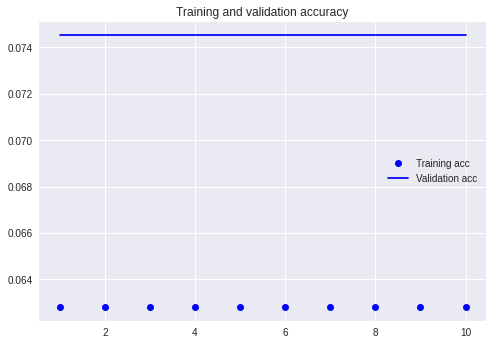

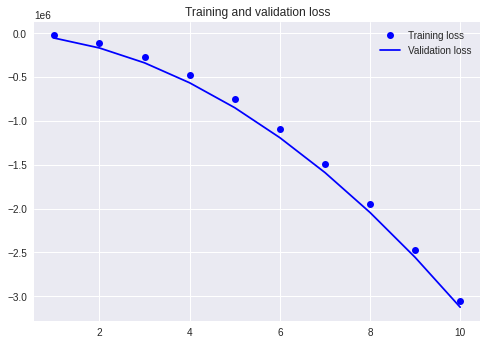

In [ ]:
import matplotlib.pyplot as plt
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']
epochs = range(1, len(acc) + 1)
plt.plot(epochs, acc, 'bo', label='Training acc')
plt.plot(epochs, val_acc, 'b', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()
plt.figure()
plt.plot(epochs, loss, 'bo', label='Training loss')
plt.plot(epochs, val_loss, 'b', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()
plt.show()